In [88]:
# Import packages
import pandas as pd
import re
import matplotlib.pyplot as plt
%matplotlib inline
pd.set_option('display.max_rows', None)

In [149]:
# Load the dataset
df = pd.read_csv('../data/superheroes_nlp_dataset.csv')

# Display the first few rows of the dataset
df.head()

,name,real_name,full_name,overall_score,history_text,powers_text,intelligence_score,strength_score,speed_score,durability_score,...,has_flight,has_accelerated_healing,has_weapons_master,has_intelligence,has_reflexes,has_super_speed,has_durability,has_stamina,has_agility,has_super_strength
0,3-D Man,"Delroy Garrett, Jr.","Delroy Garrett, Jr.",6,"Delroy Garrett, Jr. grew up to become a track ...",NaN,85,30,60,60,...,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,1.0
1,514A (Gotham),Bruce Wayne,NaN,10,He was one of the many prisoners of Indian Hil...,NaN,100,20,30,50,...,0.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0,0.0,1.0
2,A-Bomb,Richard Milhouse Jones,Richard Milhouse Jones,20,"Richard ""Rick"" Jones was orphaned at a young ...","On rare occasions, and through unusual circu...",80,100,80,100,...,0.0,1.0,0.0,0.0,1.0,1.0,1.0,1.0,1.0,1.0
3,Aa,Aa,NaN,12,Aa is one of the more passive members of the P...,NaN,80,50,55,45,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
4,Aaron Cash,Aaron Cash,Aaron Cash,5,Aaron Cash is the head of security at Arkham A...,NaN,80,10,25,40,...,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


The dataset provides information on various superheroes, including their name, real name, overall score, history, powers, and several attributes like intelligence score, strength score, speed score, and so on. Additionally, it seems to have binary indicators for various superpowers.

To proceed with the analysis, we'll follow these steps:

- **Data Cleaning**: Check for missing values, handle outliers, and ensure data types are appropriate.
- **Data Transformation**: Compute metrics that can help define the "most powerful" superhero.
- **Data Analysis**: Answer the given questions.
- **Visualization**: Create plots or diagrams that can be understood by both technical and non-technical audiences.

Let's start with **Data Cleaning**:

In [68]:
# Check for missing values in the dataset
missing_values = df.isnull().sum()

# Display columns with missing values and their counts
display(missing_values[missing_values > 0])

name                                   2
real_name                            150
full_name                            496
history_text                          90
powers_text                          366
place_of_birth                       662
first_appearance                     203
creator                              139
alignment                             82
occupation                           436
base                                 580
relatives                            572
gender                               145
type_race                            407
height                                 2
weight                                 2
eye_color                            264
hair_color                           251
skin_color                          1277
img                                   87
has_electrokinesis                    67
has_energy_constructs                 67
has_mind_control_resistance           67
has_matter_manipulation               67
has_telepathy_re

There are several columns with missing values. Here's a general approach to handle them:

1) For textual columns like real_name, full_name, history_text, and powers_text, we can fill missing values with a placeholder like "Unknown" or "Not Available".
2) For categorical columns like place_of_birth, first_appearance, creator, alignment, occupation, base, relatives, gender, type_race, eye_color, hair_color, skin_color: Fill with a placeholder like "Unknown".
3) For binary flags indicating possession of powers (e.g., has_flight, has_accelerated_healing, etc.), we can assume that if the value is missing, the superhero does not possess that power. Thus, we can fill these with 0.
4) For columns with scores (e.g., intelligence_score, strength_score, etc.), it might be reasonable to fill missing values with the median of that column. This avoids skewing the data too much.
5) For numeric columns like height and weight: Fill with median values.
6) For img: This likely refers to an image link or path. We can fill it with "Not Available".

In [69]:
# Drop rows where 'name' is missing
df = df.dropna(subset=['name'])

# Fill missing values in textual columns with "Unknown"
textual_columns = ['real_name', 'full_name', 'history_text', 'powers_text']
df[textual_columns] = df[textual_columns].fillna("Unknown")

# Fill missing values in categorical columns with "Unknown"
categorical_columns = ['place_of_birth', 'first_appearance', 'creator', 'alignment', 
                       'occupation', 'base', 'relatives', 'gender', 'type_race',
                       'eye_color', 'hair_color', 'skin_color']
df[categorical_columns] = df[categorical_columns].fillna("Unknown")


# Fill missing values in binary flag columns with 0
binary_columns = df.columns[df.columns.str.startswith("has_")]
df[binary_columns] = df[binary_columns].fillna(0)

# Fill missing values in score columns with their respective medians
score_columns = ['intelligence_score', 'strength_score', 'speed_score', 'durability_score', 'power_score', 'combat_score']
for col in score_columns:
    median_value = df[col].median()
    df[col] = df[col].fillna(median_value)
    

# Fill missing values in img column with "Not Available"
df['img'] = df['img'].fillna("Not Available")

# Check if there are still any missing values left
remaining_missing = df.isnull().sum().sum()
remaining_missing

0

Let's break down the steps for cleaning the height and weight columns using text mining:

1) For the height column:
  - Extract the height in centimeters when both feet and centimeters are provided.
  - Convert feet values to centimeters when only feet values are present.
2) For the weight column:
  - Extract the weight in kilograms when both pounds and kilograms are provided.
  - Convert pounds to kilograms when only pound values are present.

In [70]:
def extract_height_in_cm(value):
    """
    Updated function to extract height in centimeters from the provided value.
    """
    if isinstance(value, str):
        # Extract cm value
        cm_match = re.search(r'(\d+\.?\d*) cm', value)
        if cm_match:
            return float(cm_match.group(1))
        
        # Convert meters to cm
        if 'meters' in value:
            meters_match = re.search(r'(\d+\.?\d*) meters', value)
            if meters_match:
                return float(meters_match.group(1)) * 100
        
        # Convert feet and inches to cm
        feet_inches_match = re.search(r"(\d+)'(\d+\.?\d*)?", value)
        if feet_inches_match:
            feet = float(feet_inches_match.group(1))
            inches = float(feet_inches_match.group(2) or 0)
            return (feet * 30.48) + (inches * 2.54)
    return value



def extract_weight_in_kg(value):
    """
    Extract weight in kilograms from the provided value.
    """
    if isinstance(value, str):
        # Extract kg value when both lb and kg are provided
        kg_match = re.search(r'(\d+\.?\d*) kg', value)
        if kg_match:
            return float(kg_match.group(1))
        
        # Convert lb to kg when only lb values are provided
        lb_match = re.search(r'(\d+\.?\d*) lb', value)
        if lb_match:
            return float(lb_match.group(1)) * 0.453592
    return value

# Extract height in cm and weight in kg
df['height_cm'] = df['height'].apply(extract_height_in_cm)
df['weight_kg'] = df['weight'].apply(extract_weight_in_kg)

# Replace "-" values with 0
df['height_cm'] = df['height_cm'].replace("-", 0).astype(float)
df['height_cm'] = df['height_cm'].replace("-", 0).astype(float)

(array([457., 149., 254.,  99., 121.,  78.,  18.,  69.,  29.,  26.,  21.,
         14.,   6.,  18.,   8.,   9.,  12.,   9.,  12.,  10.,   5.,   8.,
          5.,   6.,   5.]),
 array([  0.  ,   4.76,   9.52,  14.28,  19.04,  23.8 ,  28.56,  33.32,
         38.08,  42.84,  47.6 ,  52.36,  57.12,  61.88,  66.64,  71.4 ,
         76.16,  80.92,  85.68,  90.44,  95.2 ,  99.96, 104.72, 109.48,
        114.24, 119.  ]),
 <BarContainer object of 25 artists>)

Text(0.5, 1.0, 'Distribution of Height (in cm)')

Text(0.5, 0, 'Height (cm)')

Text(0, 0.5, 'Frequency')

(array([534., 105.,  92.,  55.,  49.,  61.,  87.,  31.,  48.,  31.,  21.,
         41.,  40.,  30.,  24.,  19.,  15.,  20.,  13.,  20.,  12.,   9.,
          8.,  12.,  21.,  11.,  11.,  10.,   9.,   9.]),
 array([  0.        ,   8.16666667,  16.33333333,  24.5       ,
         32.66666667,  40.83333333,  49.        ,  57.16666667,
         65.33333333,  73.5       ,  81.66666667,  89.83333333,
         98.        , 106.16666667, 114.33333333, 122.5       ,
        130.66666667, 138.83333333, 147.        , 155.16666667,
        163.33333333, 171.5       , 179.66666667, 187.83333333,
        196.        , 204.16666667, 212.33333333, 220.5       ,
        228.66666667, 236.83333333, 245.        ]),
 <BarContainer object of 30 artists>)

Text(0.5, 1.0, 'Distribution of Weight (in kg)')

Text(0.5, 0, 'Weight (kg)')

Text(0, 0.5, 'Frequency')

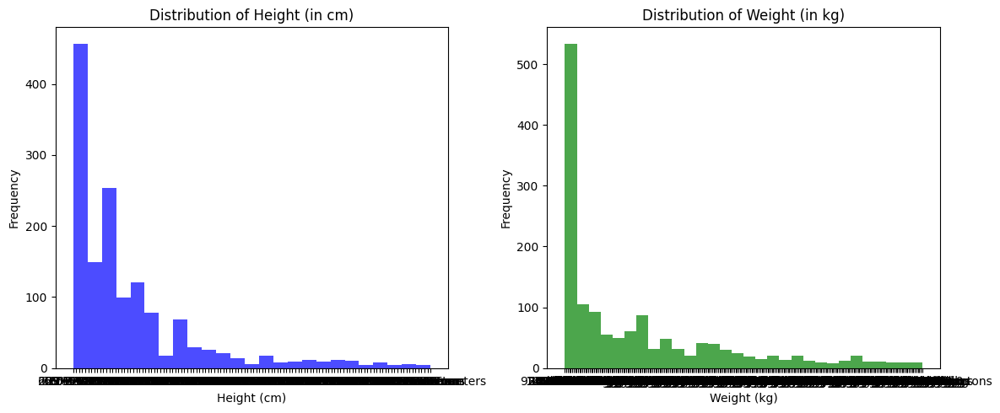

In [80]:
# Analyzing the distributions of height and weight using histograms
fig, ax = plt.subplots(1, 2, figsize=(12, 5))

# Plotting the histogram for height
ax[0].hist(df['height'], bins=25, color='blue', alpha=0.7)
ax[0].set_title('Distribution of Height (in cm)')
ax[0].set_xlabel('Height (cm)')
ax[0].set_ylabel('Frequency')

# Plotting the histogram for weight
ax[1].hist(df['weight'], bins=30, color='green', alpha=0.7)
ax[1].set_title('Distribution of Weight (in kg)')
ax[1].set_xlabel('Weight (kg)')
ax[1].set_ylabel('Frequency')

plt.tight_layout()
plt.show()

- The height distribution shows that most superheroes have heights ranging from 150 cm to 200 cm, with a few outliers.
- The weight distribution indicates that most superheroes weigh between 40 kg and 120 kg, with a few heavier outliers.

In [85]:
# Replace '∞' with 600 as there are 6 power stat features with 100 max value in each and '-' with 0 
df['overall_score'] = df['overall_score'].replace('∞', '600').replace('-', '0').astype(float)

To determine the most powerful superhero, we need a criterion. Here's a proposed approach:

- **Overall Score**: We can use the 'overall_score' column directly to rank the superheroes.
- **Aggregate Score**: We can sum up the individual scores (e.g., intelligence_score, strength_score, etc.) to come up with an aggregate score for each superhero.


Let's start by examining the distribution of **'overall_score'** to ensure its viability as a criterion and its relationships with power stats features(**'intelligence_score**', **'strength_score**', **'speed_score**', **'durability_score**', **'power_score**' and **'combat_score**'.

<Figure size 1200x600 with 0 Axes>

<Axes: >

Text(0.5, 1.0, 'Distribution of Overall Scores')

Text(0.5, 0, 'Overall Score')

Text(0, 0.5, 'Number of Superheroes')

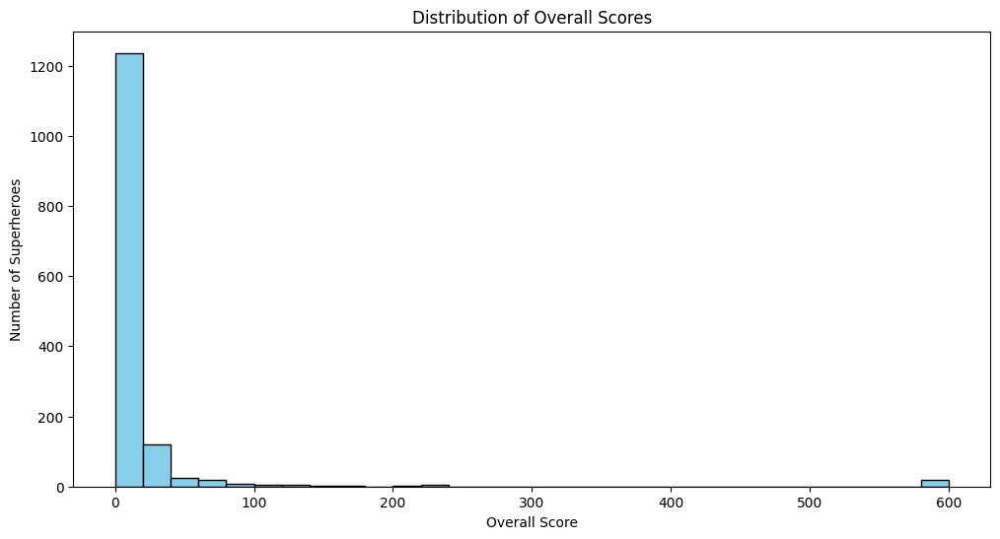

In [91]:
# Plot the distribution of 'overall_score'
plt.figure(figsize=(12, 6))
df['overall_score'].hist(bins=30, color='skyblue', edgecolor='black')
plt.title('Distribution of Overall Scores')
plt.xlabel('Overall Score')
plt.ylabel('Number of Superheroes')
plt.grid(False)
%matplotlib inline
plt.show()

The distribution of the 'overall_score' is skewed to the left, with most superheroes scoring between 5 and 15. Only a few superheroes have a score above 20.

In [99]:
# Calculate the correlation coefficients
correlation_matrix = df[['overall_score', 'intelligence_score', 'strength_score', 'speed_score', 
                                       'durability_score', 'power_score', 'combat_score']].corr()

correlation_with_overall = correlation_matrix['overall_score'].drop('overall_score')

correlation_with_overall

intelligence_score    0.166661
strength_score        0.324079
speed_score           0.334958
durability_score      0.272344
power_score           0.226657
combat_score          0.152470
Name: overall_score, dtype: float64

- The **Speed Score** has the strongest positive correlation with the **overall_score**, followed closely by the **Strength Score**.
- **Combat Score** has the weakest correlation with the **overall_score**.

Next, let's visualize these relationships with scatter plots for a clearer understanding.

<Figure size 1800x1200 with 0 Axes>

<Axes: >

Text(0.5, 1.0, 'Relationship between Overall Score and intelligence_score')

Text(0.5, 0, 'intelligence_score')

Text(0, 0.5, 'Overall Score')

<Axes: >

Text(0.5, 1.0, 'Relationship between Overall Score and strength_score')

Text(0.5, 0, 'strength_score')

Text(0, 0.5, 'Overall Score')

<Axes: >

Text(0.5, 1.0, 'Relationship between Overall Score and speed_score')

Text(0.5, 0, 'speed_score')

Text(0, 0.5, 'Overall Score')

<Axes: >

Text(0.5, 1.0, 'Relationship between Overall Score and durability_score')

Text(0.5, 0, 'durability_score')

Text(0, 0.5, 'Overall Score')

<Axes: >

Text(0.5, 1.0, 'Relationship between Overall Score and power_score')

Text(0.5, 0, 'power_score')

Text(0, 0.5, 'Overall Score')

<Axes: >

Text(0.5, 1.0, 'Relationship between Overall Score and combat_score')

Text(0.5, 0, 'combat_score')

Text(0, 0.5, 'Overall Score')

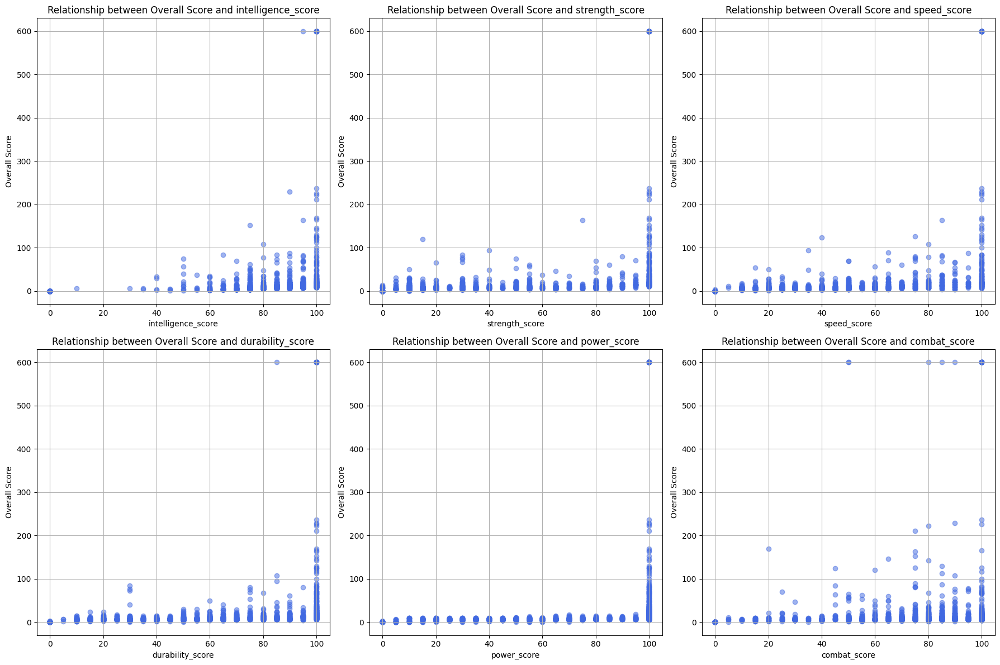

In [102]:
# Visualizing the relationships with scatter plots
power_stats_features = ['intelligence_score', 'strength_score', 'speed_score', 
                        'durability_score', 'power_score', 'combat_score']

#filtered_df = df[df.overall_score < 600]

plt.figure(figsize=(18, 12))
for i, feature in enumerate(power_stats_features, 1):
    plt.subplot(2, 3, i)
    plt.scatter(df[feature],df['overall_score'], alpha=0.5, color='royalblue')
    plt.title(f'Relationship between Overall Score and {feature}')
    plt.xlabel(feature)
    plt.ylabel('Overall Score')
    plt.grid(True)

plt.tight_layout()
plt.show()


The scatter plots visualize the relationship between the overall_score and each of the power stats features:

- Intelligence Score: A moderate positive correlation is observed, but the relationship doesn't seem very strong.
- Strength Score: There's a clearer positive trend, suggesting that as the strength score increases, the overall score tends to increase.
- Speed Score: A similar positive trend is observed, comparable to the strength score.
- Durability Score: A positive relationship is observed, albeit less defined than speed and strength.
- Power Score: The relationship is positive but dispersed across different overall scores.
- Combat Score: The points are quite scattered, indicating a weak relationship with the overall score.

#### 1) How would you define most powerful superhero from the information available in dataset?
- a. Who is the most powerful superhero from each creator?

In [361]:
sorted_heroes_by_creator[0:10]

,creator,name,aggregate_score
525,Lego,Golden Ninja,600
843,Image Comics,Man Of Miracles,600
480,Unknown,First Spinjitzu Master,600
536,DC Comics,Great Evil Beast,600
11,Marvel Comics,Abraxas,600
1287,George R. R. Martin,The Lord Of Light,600
448,J. R. R. Tolkien,Eru Iluvatar,600
832,Shueisha,Madara Uchiha,590
587,Dark Horse Comics,Hellboy (Injustice 2),575
419,Konami,Dracula,575


(name               Abraxas
 aggregate_score        600
 Name: 11, dtype: object,
                      creator                    name  aggregate_score
 682              ABC Studios              Jim Powell              260
 17    Blizzard Entertainment                   A'dal              405
 97                    Capcom                   Asura              560
 1088         Cartoon Network            Rick Sanchez              365
 241             Clive Barker              Butterball              375
 536                DC Comics        Great Evil Beast              600
 587        Dark Horse Comics   Hellboy (Injustice 2)              575
 861                   Disney                    Maui              460
 657               Dreamworks              Jack Frost              380
 646             George Lucas     Iron Man (Model 45)              490
 1287     George R. R. Martin       The Lord Of Light              600
 165            Hanna-Barbera                 Birdman             

<Figure size 1500x2000 with 0 Axes>

<BarContainer object of 42 artists>

Text(0.5, 0, 'Aggregate Score')

Text(0, 0.5, 'Creator')

Text(0.5, 1.0, 'Most Powerful Superhero by Creator')

Text(600, 0, ' Golden Ninja')

Text(600, 1, ' Man Of Miracles')

Text(600, 2, ' First Spinjitzu Master')

Text(600, 3, ' Great Evil Beast')

Text(600, 4, ' Abraxas')

Text(600, 5, ' The Lord Of Light')

Text(600, 6, ' Eru Iluvatar')

Text(590, 7, ' Madara Uchiha')

Text(575, 8, ' Hellboy (Injustice 2)')

Text(575, 9, ' Dracula')

Text(565, 10, ' Unicron')

Text(560, 11, ' Asura')

Text(555, 12, ' Skeletor')

Text(550, 13, ' Master Hand')

Text(535, 14, ' Kratos')

Text(520, 15, ' Peter Petrelli')

Text(490, 16, ' Iron Man (Model 45)')

Text(485, 17, ' Selene')

Text(480, 18, ' Hancock')

Text(465, 19, ' Scorpion (injustice)')

Text(460, 20, ' Maui')

Text(455, 21, ' Sonic The Hedgehog')

Text(450, 22, ' Lord Of Cinder')

Text(450, 23, ' Master Chief')

Text(445, 24, ' Superking')

Text(425, 25, ' Professor Dumbledore')

Text(415, 26, ' IT')

Text(410, 27, ' Birdman')

Text(405, 28, " A'dal")

Text(395, 29, ' The Prince')

Text(380, 30, ' Jack Frost')

Text(380, 31, ' Gru')

Text(375, 32, ' Butterball')

Text(365, 33, ' Rick Sanchez')

Text(295, 34, ' Data')

Text(275, 35, ' Bill Harken')

Text(275, 36, ' James Bond (Craig)')

Text(260, 37, ' Jim Powell')

Text(225, 38, ' Hit-Girl')

Text(220, 39, ' Captain Hindsight')

Text(60, 40, ' Master Brood')

Text(5, 41, ' Energy')

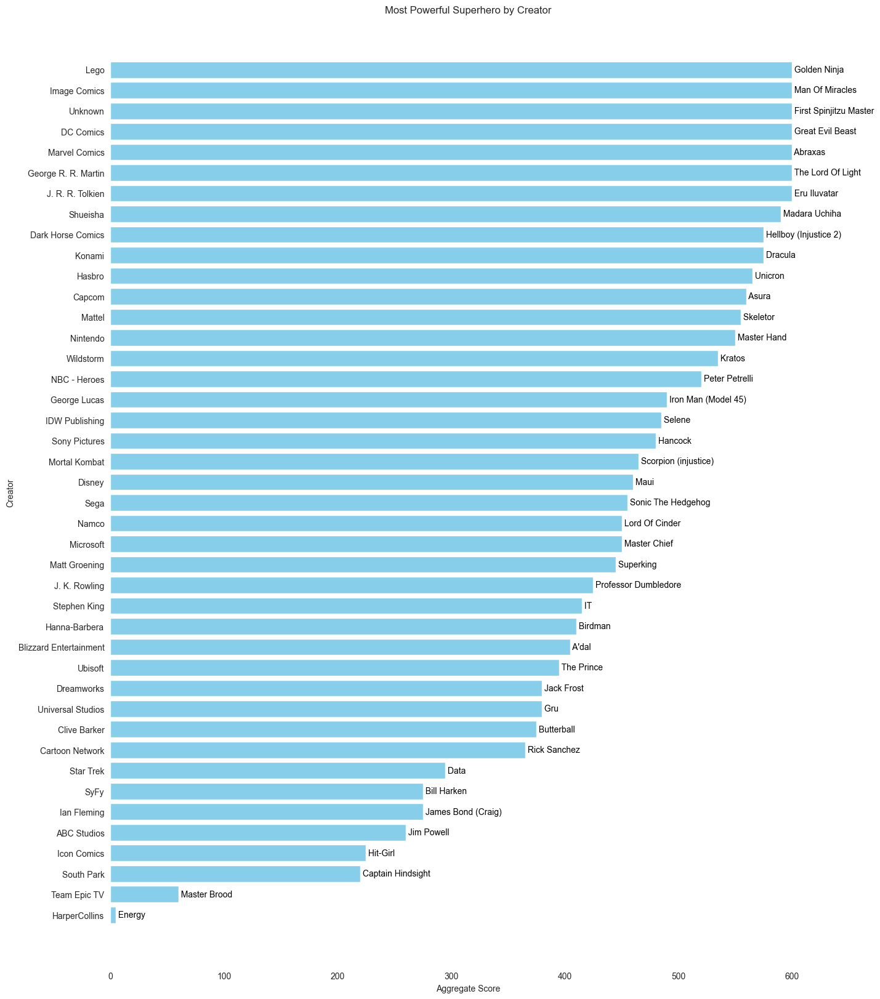

In [355]:
# Aggregate the individual scores to get a total score for each superhero
df['aggregate_score'] = df[['intelligence_score', 'strength_score', 'speed_score', 
                                                       'durability_score', 'power_score', 'combat_score']].sum(axis=1)

# Get the superhero with the highest aggregate score overall
most_powerful_superhero = df.loc[df['aggregate_score'].idxmax()]

# Get the most powerful superhero for each creator
most_powerful_by_creator = df.groupby('creator')['aggregate_score'].idxmax()
most_powerful_heroes_by_creator = df.loc[most_powerful_by_creator][['creator', 'name', 'aggregate_score']]

most_powerful_superhero[['name', 'aggregate_score']], most_powerful_heroes_by_creator

# Sorting the most powerful heroes by creator for better visualization
sorted_heroes_by_creator = most_powerful_heroes_by_creator.sort_values('aggregate_score', ascending=False)

# Visualizing the most powerful superheroes by creator
plt.figure(figsize=(15, 20))
plt.barh(sorted_heroes_by_creator['creator'], sorted_heroes_by_creator['aggregate_score'], color='skyblue')
plt.xlabel('Aggregate Score')
plt.ylabel('Creator')
plt.title('Most Powerful Superhero by Creator')
plt.gca().invert_yaxis()  # Invert y-axis for better readability
plt.grid(False)

ax = plt.gca()
for spine in ax.spines.values():
    spine.set_visible(False)

# Annotating the superhero names
for index, value in enumerate(sorted_heroes_by_creator['name']):
    plt.text(sorted_heroes_by_creator['aggregate_score'].iloc[index], index, 
             ' ' + value, color='black', va="center")

#plt.tight_layout()
plt.show()

In [357]:
sorted_heroes_by_creator[0:10]

,creator,name,aggregate_score
525,Lego,Golden Ninja,600
843,Image Comics,Man Of Miracles,600
480,Unknown,First Spinjitzu Master,600
536,DC Comics,Great Evil Beast,600
11,Marvel Comics,Abraxas,600
1287,George R. R. Martin,The Lord Of Light,600
448,J. R. R. Tolkien,Eru Iluvatar,600
832,Shueisha,Madara Uchiha,590
587,Dark Horse Comics,Hellboy (Injustice 2),575
419,Konami,Dracula,575


<Figure size 1500x2000 with 0 Axes>

<BarContainer object of 42 artists>

Text(0.5, 0, 'Overall Score')

Text(0, 0.5, 'Creator')

Text(0.5, 1.0, 'Most Powerful Superhero by Creator (Based on Overall Score)')

Text(600, 0, ' The Lord Of Light')

Text(600, 1, ' Man Of Miracles')

Text(600, 2, ' First Spinjitzu Master')

Text(600, 3, ' Black Alice')

Text(600, 4, ' Abraxas')

Text(600, 5, ' Eru Iluvatar')

Text(229, 6, ' Devilman')

Text(226, 7, ' Golden Ninja')

Text(211, 8, ' Dracula')

Text(146, 9, ' Unicron')

Text(84, 10, ' Darth Nihilus')

Text(75, 11, ' Shao Kahn')

Text(69, 12, ' Link')

Text(53, 13, ' Sonic The Hedgehog')

Text(40, 14, ' Peter Petrelli')

Text(38, 15, ' Hellboy (Injustice 2)')

Text(35, 16, ' Skeletor')

Text(32, 17, ' Asura')

Text(31, 18, ' Professor Dumbledore')

Text(28, 19, ' Castiel')

Text(21, 20, ' Pinhead')

Text(21, 21, ' Chosen Undead')

Text(19, 22, ' Rick Sanchez')

Text(16, 23, ' IT')

Text(15, 24, ' Penny')

Text(13, 25, ' Maui')

Text(12, 26, ' Hancock')

Text(10, 27, ' Selene')

Text(10, 28, ' Gru')

Text(10, 29, ' The Prince')

Text(10, 30, ' Data')

Text(9, 31, ' Master Chief')

Text(9, 32, ' Birdman')

Text(9, 33, ' Jack Frost')

Text(8, 34, ' James Bond (Craig)')

Text(8, 35, ' Superking')

Text(7, 36, ' JJ Powell')

Text(7, 37, " A'dal")

Text(5, 38, ' Hit-Girl')

Text(3, 39, ' Captain Hindsight')

Text(0, 40, ' Captain Epic')

Text(0, 41, ' Colin Wagner')

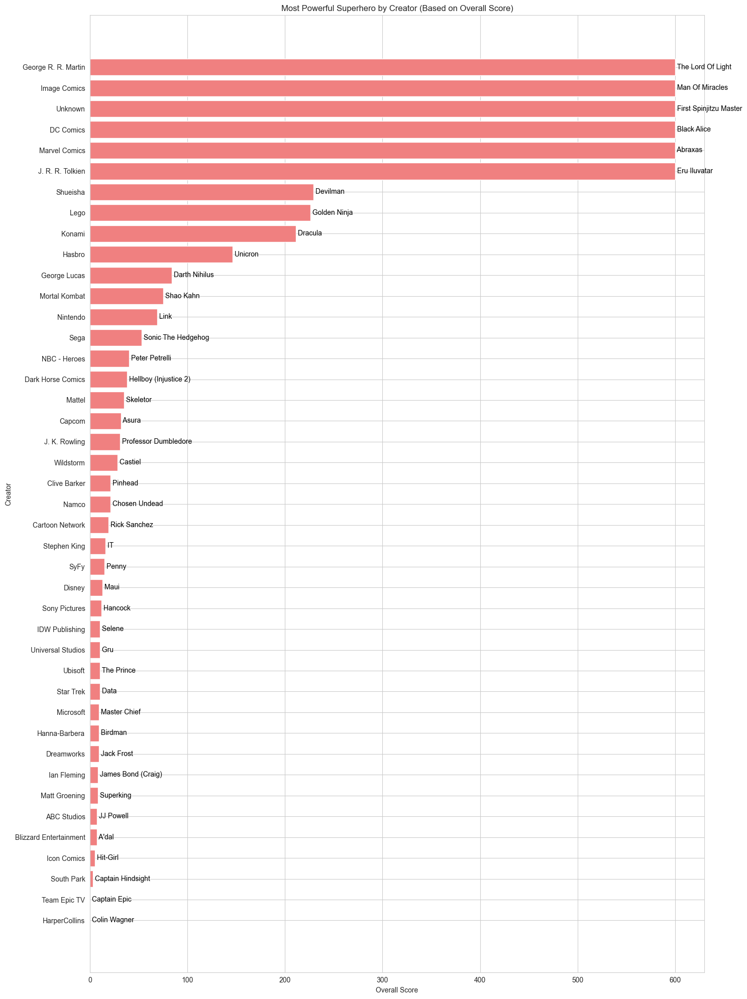

In [348]:
# Get the superhero with the highest overall score
most_powerful_superhero_overall = df.loc[df['overall_score'].idxmax()]

# Get the most powerful superhero for each creator based on overall_score
most_powerful_by_creator_overall = df.groupby('creator')['overall_score'].idxmax()
most_powerful_heroes_by_creator_overall = df.loc[most_powerful_by_creator_overall][['creator', 'name', 'overall_score']]

# Sorting the most powerful heroes by creator for better visualization
sorted_heroes_by_creator_overall = most_powerful_heroes_by_creator_overall.sort_values('overall_score', ascending=False)

# Visualizing the most powerful superheroes by creator based on overall_score
plt.figure(figsize=(15, 20))
plt.barh(sorted_heroes_by_creator_overall['creator'], sorted_heroes_by_creator_overall['overall_score'], color='lightcoral')
plt.xlabel('Overall Score')
plt.ylabel('Creator')
plt.title('Most Powerful Superhero by Creator (Based on Overall Score)')
plt.gca().invert_yaxis()  # Invert y-axis for better readability
# plt.grid(axis='x')

# Annotating the superhero names
for index, value in enumerate(sorted_heroes_by_creator_overall['name']):
    plt.text(sorted_heroes_by_creator_overall['overall_score'].iloc[index], index, 
             ' ' + value, color='black', va="center")

plt.tight_layout()
plt.show()

#### 2) Find the top 5 superpowers in descending order.
To determine the top 5 superpowers, we'll need to analyze the columns that indicate the presence of specific powers (binary columns). We'll count the number of occurrences for each superpower and then list the top 5 based on their frequency.


In [120]:
# Extract columns related to superpowers (binary columns starting from 'has_gender' till the end, except height and weight columns)
superpower_columns = df.columns[df.columns.str.startswith("has_")]

# Sum up the occurrences of each superpower
superpower_counts = df[superpower_columns].sum().sort_values(ascending=False)

# Extract the top 5 superpowers
top_5_superpowers = superpower_counts.head(5)
top_5_superpowers

has_agility           778.0
has_stamina           737.0
has_super_strength    731.0
has_durability        708.0
has_intelligence      599.0
dtype: float64

<Figure size 1200x700 with 0 Axes>

/var/folders/_k/hvj2j92j10v0n49lt6p25wyw0000gp/T/ipykernel_55554/641541547.py:11: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x=top_5_superpowers.index.str.replace("has_", "").str.replace("_", " ").str.title(),


<Axes: xlabel='None'>

Text(0.5, 1.0, 'Top 5 Superpowers Among Superheroes')

Text(0.5, 0, 'Superpower')

Text(0, 0.5, 'Number of Superheroes')

([0, 1, 2, 3, 4],
 [Text(0, 0, 'Agility'),
  Text(1, 0, 'Stamina'),
  Text(2, 0, 'Super Strength'),
  Text(3, 0, 'Durability'),
  Text(4, 0, 'Intelligence')])

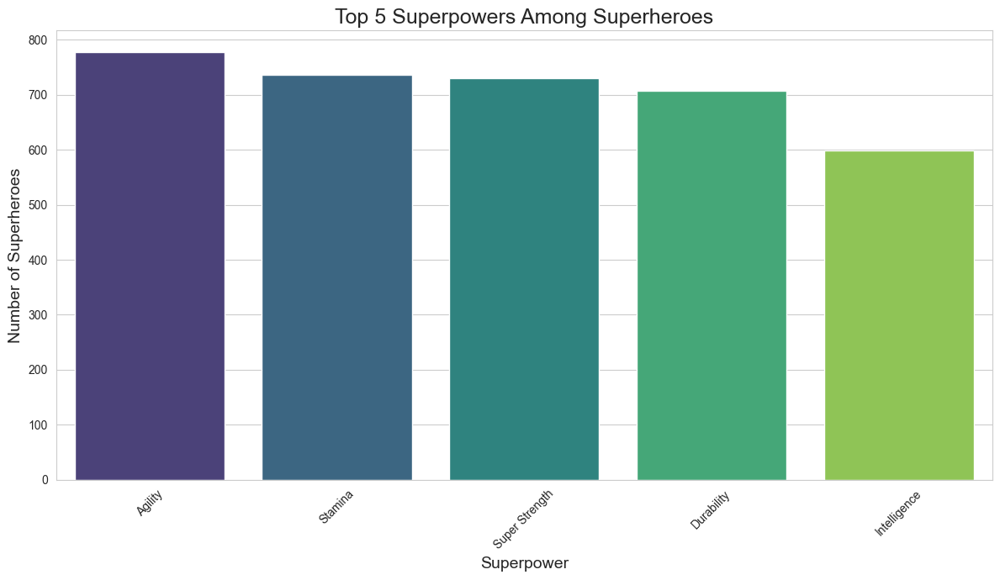

In [123]:
import matplotlib.pyplot as plt
import seaborn as sns

# Set the style for the visualization
sns.set_style("whitegrid")

# Initialize the figure
plt.figure(figsize=(12, 7))

# Plot the top 5 superpowers
sns.barplot(x=top_5_superpowers.index.str.replace("has_", "").str.replace("_", " ").str.title(), 
            y=top_5_superpowers.values,
            palette="viridis")

# Set the title and labels
plt.title("Top 5 Superpowers Among Superheroes", fontsize=18)
plt.xlabel("Superpower", fontsize=14)
plt.ylabel("Number of Superheroes", fontsize=14)
plt.xticks(rotation=45)

# Display the visualization
plt.tight_layout()
plt.show()


#### 3) Which race has the most immortal superheroes?

<Figure size 1200x700 with 0 Axes>

/var/folders/_k/hvj2j92j10v0n49lt6p25wyw0000gp/T/ipykernel_55554/1671298443.py:13: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x=top_races_immortal.index,


<Axes: xlabel='type_race'>

Text(0.5, 1.0, 'Races with the Most Immortal Superheroes')

Text(0.5, 0, 'Race/Species')

Text(0, 0.5, 'Number of Immortal Superheroes')

([0, 1, 2, 3, 4],
 [Text(0, 0, 'Unknown'),
  Text(1, 0, 'God / Eternal'),
  Text(2, 0, 'Human'),
  Text(3, 0, 'Demon'),
  Text(4, 0, 'New God')])

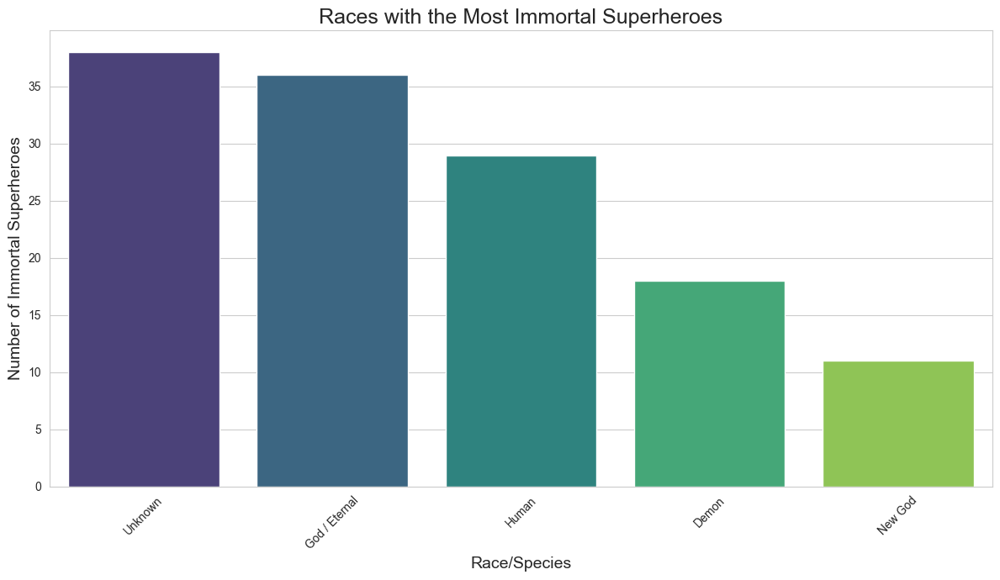

In [127]:
# Filter superheroes with the immortality superpower
immortal_heroes = df[df['has_immortality'] == 1]

race_immortal_counts = immortal_heroes['type_race'].value_counts()

# Display the top races with the most immortal superheroes
top_races_immortal = race_immortal_counts.head()

# Initialize the figure for visualization
plt.figure(figsize=(12, 7))

# Plot the top races with the most immortal superheroes
sns.barplot(x=top_races_immortal.index, 
            y=top_races_immortal.values, 
            palette="viridis")

# Set the title and labels
plt.title("Races with the Most Immortal Superheroes", fontsize=18)
plt.xlabel("Race/Species", fontsize=14)
plt.ylabel("Number of Immortal Superheroes", fontsize=14)
plt.xticks(rotation=45)

# Display the visualization
plt.tight_layout()
plt.show()

#### 4) Name the creator having most superheroes of type “Parademon”.

<Figure size 1200x700 with 0 Axes>

/var/folders/_k/hvj2j92j10v0n49lt6p25wyw0000gp/T/ipykernel_55554/574408169.py:14: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x=top_creators_parademon.index,


<Axes: xlabel='creator'>

Text(0.5, 1.0, "Creators with the Most Superheroes of Type 'Parademon'")

Text(0.5, 0, 'Creator')

Text(0, 0.5, 'Number of Superheroes')

([0], [Text(0, 0, 'DC Comics')])

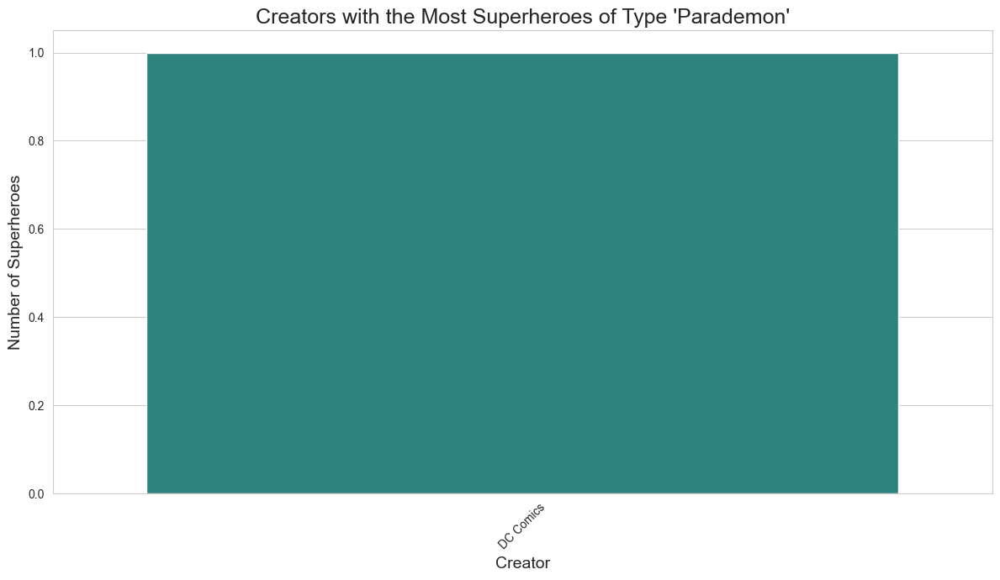

In [130]:
# Filter superheroes of type "Parademon"
parademon_heroes = df[df['type_race'] == "Parademon"]

# Group by creator and count the number of superheroes
creator_counts = parademon_heroes['creator'].value_counts()

# Display the top creators with the most superheroes of type "Parademon"
top_creators_parademon = creator_counts.head()

# Initialize the figure for visualization
plt.figure(figsize=(12, 7))

# Plot the top creators with the most superheroes of type "Parademon"
sns.barplot(x=top_creators_parademon.index, 
            y=top_creators_parademon.values, 
            palette="viridis")

# Set the title and labels
plt.title("Creators with the Most Superheroes of Type 'Parademon'", fontsize=18)
plt.xlabel("Creator", fontsize=14)
plt.ylabel("Number of Superheroes", fontsize=14)
plt.xticks(rotation=45)

# Display the visualization
plt.tight_layout()
plt.show()


#### 5) Which comic creator has most superhero teams?
- a. Find names, real names and alias of superhero who is part of most teams.
- b. Are there any crossovers between creators and teams?

<Figure size 1200x700 with 0 Axes>

/var/folders/_k/hvj2j92j10v0n49lt6p25wyw0000gp/T/ipykernel_55554/643391544.py:20: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x=top_creators_teams.index,


<Axes: xlabel='creator'>

Text(0.5, 1.0, 'Comic Creators with the Most Superhero Teams')

Text(0.5, 0, 'Creator')

Text(0, 0.5, 'Number of Superhero Teams')

([0, 1, 2, 3, 4],
 [Text(0, 0, 'Marvel Comics'),
  Text(1, 0, 'DC Comics'),
  Text(2, 0, 'Unknown'),
  Text(3, 0, 'Shueisha'),
  Text(4, 0, 'Dark Horse Comics')])

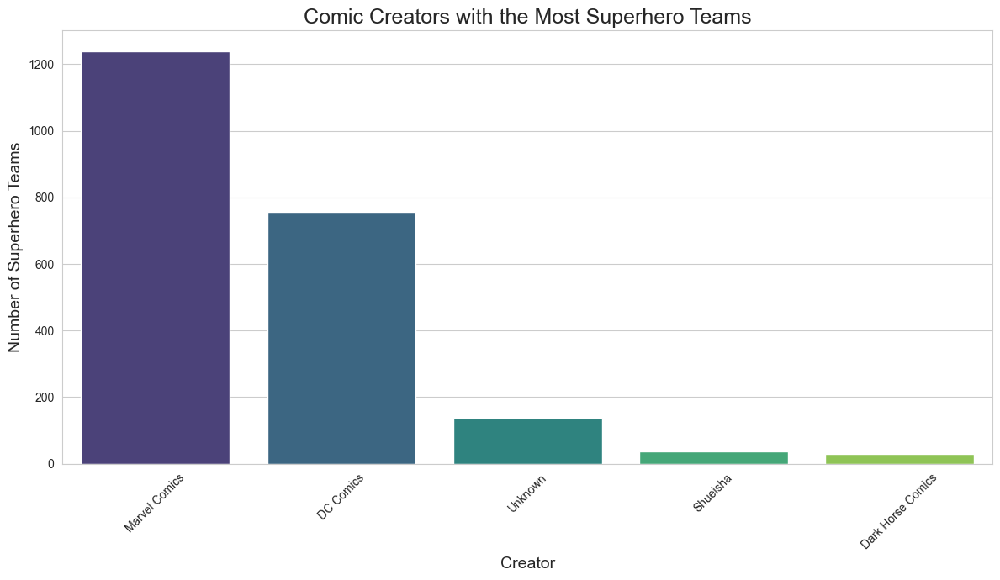

'Marvel Comics'

In [132]:
# Since the 'teams' column might contain multiple teams separated by commas or other delimiters,
# we'll create a function to count the number of teams for each superhero

def count_teams(teams):
    if isinstance(teams, str):
        return len(teams.split(","))
    return 0

# Apply the function to the 'teams' column
df['num_teams'] = df['teams'].apply(count_teams)

# Group by 'creator' and sum the number of teams
creator_team_counts = df.groupby('creator')['num_teams'].sum().sort_values(ascending=False)

# Display the top creators with the most superhero teams
top_creators_teams = creator_team_counts.head()

# Visualize the results
plt.figure(figsize=(12, 7))
sns.barplot(x=top_creators_teams.index, 
            y=top_creators_teams.values, 
            palette="viridis")
plt.title("Comic Creators with the Most Superhero Teams", fontsize=18)
plt.xlabel("Creator", fontsize=14)
plt.ylabel("Number of Superhero Teams", fontsize=14)
plt.xticks(rotation=45)
plt.tight_layout()
plt.show()

# Return the name of the top creator
top_creator = top_creators_teams.idxmax()
top_creator


#### 5.a Find names, real names and alias of superhero who is part of most teams.

In [138]:
# Identify the superhero with the most teams
most_teams_hero = df[df['num_teams'] == df['num_teams'].max()]

# Extract their names, real names, and aliases
hero_details = most_teams_hero[['name', 'real_name', 'aliases']]

display(hero_details)


,name,real_name,aliases
1415,Wolverine,Logan,"['Weapon X, Weapon Ten, Death, Mutate 9601, Ji..."


#### 5.b Are there any crossovers between creators and teams?

<Figure size 1500x1000 with 0 Axes>

<Axes: xlabel='creator', ylabel='teams'>

Text(0.5, 1.0, 'Crossovers Between Creators and Teams')

Text(0.5, 80.7222222222222, 'Comic Creator')

Text(158.22222222222217, 0.5, 'Superhero Teams')

(array([ 0.5,  1.5,  2.5,  3.5,  4.5,  5.5,  6.5,  7.5,  8.5,  9.5, 10.5,
        11.5, 12.5, 13.5, 14.5, 15.5, 16.5, 17.5, 18.5, 19.5, 20.5, 21.5,
        22.5, 23.5, 24.5, 25.5, 26.5, 27.5, 28.5, 29.5, 30.5, 31.5, 32.5,
        33.5, 34.5, 35.5, 36.5, 37.5, 38.5, 39.5, 40.5, 41.5]),
 [Text(0.5, 0, 'ABC Studios'),
  Text(1.5, 0, 'Blizzard Entertainment'),
  Text(2.5, 0, 'Capcom'),
  Text(3.5, 0, 'Cartoon Network'),
  Text(4.5, 0, 'Clive Barker'),
  Text(5.5, 0, 'DC Comics'),
  Text(6.5, 0, 'Dark Horse Comics'),
  Text(7.5, 0, 'Disney'),
  Text(8.5, 0, 'Dreamworks'),
  Text(9.5, 0, 'George Lucas'),
  Text(10.5, 0, 'George R. R. Martin'),
  Text(11.5, 0, 'Hanna-Barbera'),
  Text(12.5, 0, 'HarperCollins'),
  Text(13.5, 0, 'Hasbro'),
  Text(14.5, 0, 'IDW Publishing'),
  Text(15.5, 0, 'Ian Fleming'),
  Text(16.5, 0, 'Icon Comics'),
  Text(17.5, 0, 'Image Comics'),
  Text(18.5, 0, 'J. K. Rowling'),
  Text(19.5, 0, 'J. R. R. Tolkien'),
  Text(20.5, 0, 'Konami'),
  Text(21.5, 0, 'Lego'),
  Te

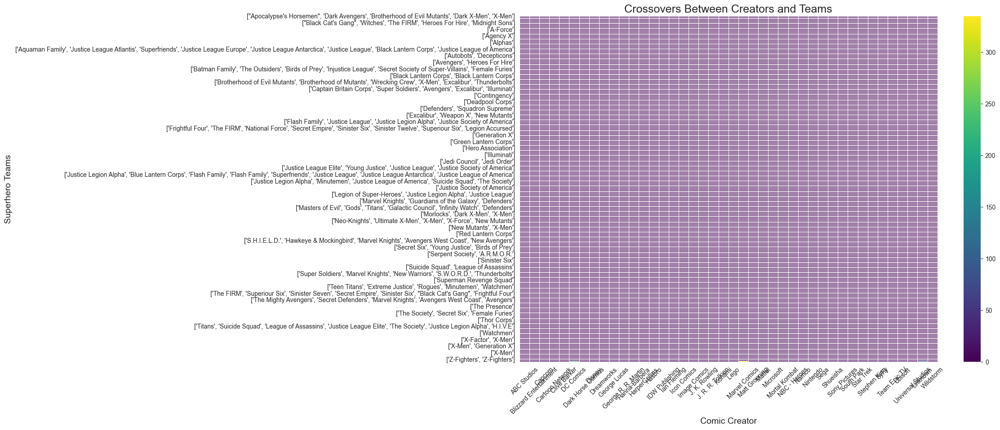

In [135]:
# Since the 'teams' column might contain multiple teams for a superhero,
# we'll expand this column and create a DataFrame with one row for each team for each superhero

teams_expanded = df.explode('teams')[['name', 'teams', 'creator']].dropna()

# Group by 'creator' and 'teams' to count the number of superheroes in each team for each creator
creator_team_crossover = teams_expanded.groupby(['creator', 'teams']).size().reset_index(name='count')

# Pivot the data for visualization
creator_team_pivot = creator_team_crossover.pivot_table(index='teams', columns='creator', values='count', fill_value=0)

# Visualize the crossovers
plt.figure(figsize=(15, 10))
sns.heatmap(creator_team_pivot, cmap="viridis", linewidths=.5)
plt.title("Crossovers Between Creators and Teams", fontsize=18)
plt.xlabel("Comic Creator", fontsize=14)
plt.ylabel("Superhero Teams", fontsize=14)
plt.xticks(rotation=45)
#plt.tight_layout()
plt.show()


In [140]:
# Filter teams that are associated with more than one creator
teams_with_crossovers = teams_expanded.groupby('teams')['creator'].nunique().sort_values(ascending=False)
teams_with_crossovers = teams_with_crossovers[teams_with_crossovers > 1]

# Filter our expanded dataset to only include these teams
crossover_data = teams_expanded[teams_expanded['teams'].isin(teams_with_crossovers.index)]
# Identify teams associated with multiple creators
teams_multiple_creators = crossover_data.groupby('teams')['creator'].unique().reset_index()

# Filter out teams with only one creator
teams_multiple_creators = teams_multiple_creators[teams_multiple_creators['creator'].apply(len) > 1]

teams_multiple_creators

,teams,creator
0,['Flex Fighters'],"[Cartoon Network, Unknown]"
1,['Incredible Family'],"[Dark Horse Comics, Disney]"
2,[],"[DC Comics, Marvel Comics, Unknown, Blizzard E..."


#### 6) What are the characteristics that can predict a superhero alignment.

<Figure size 1200x1000 with 0 Axes>

<Axes: >

Text(0.5, 1.0, 'Correlation of Features with Superhero Alignment')

Text(0.5, 0, 'Correlation Coefficient')

Text(0, 0.5, 'Features')

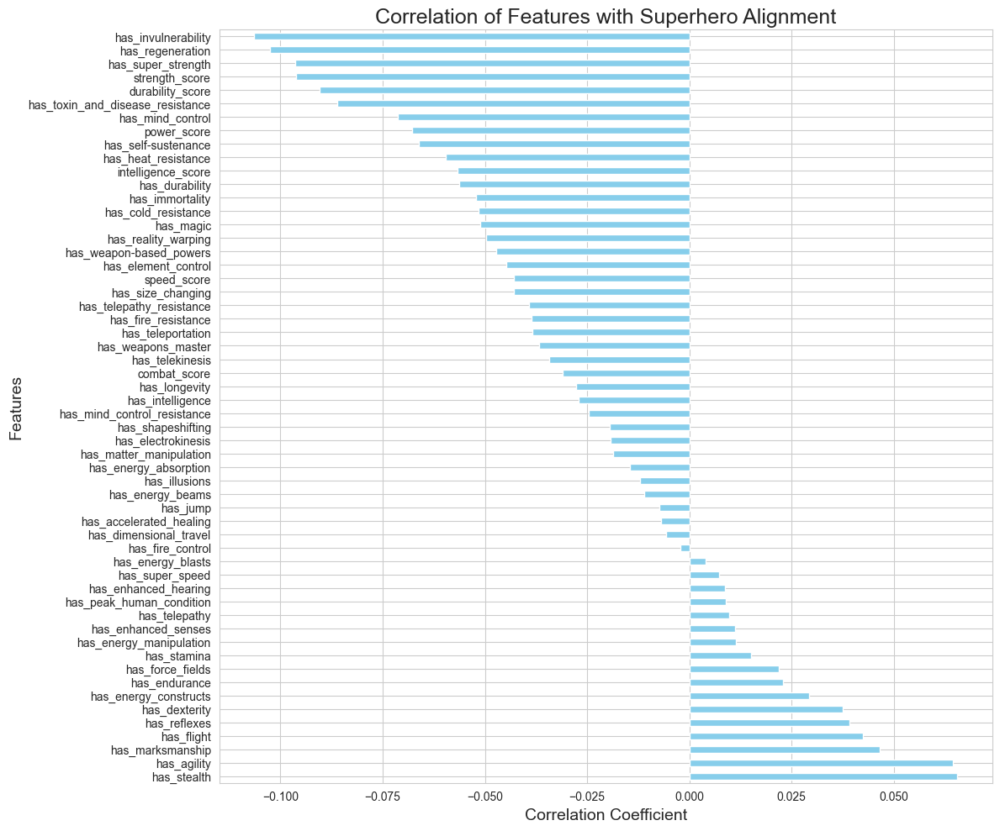

In [167]:
# Encode the 'alignment' column as numerical values
alignment_mapping = {'Good': 1, 'Neutral': 0, 'Bad': -1, 'Unknown': -2}
df['alignment_encoded'] = df['alignment'].map(alignment_mapping)

# Calculate the correlation of numerical features with alignment
correlation_with_alignment = df[binary_columns].corr()['alignment_encoded'].sort_values(ascending=False)

# # Select top and bottom correlated features for visualization
# top_correlated_features = correlation_with_alignment.head(10).append(correlation_with_alignment.tail(10))

# # Visualize the correlation
# plt.figure(figsize=(12, 10))
# top_correlated_features.plot(kind='barh', color='skyblue')
# plt.title("Correlation of Features with Superhero Alignment", fontsize=18)
# plt.xlabel("Correlation Coefficient", fontsize=14)
# plt.ylabel("Features", fontsize=14)
# plt.tight_layout()
# plt.show()


plt.figure(figsize=(12, 10))
correlation_with_alignment[1:].plot(kind='barh', color='skyblue')
plt.title("Correlation of Features with Superhero Alignment", fontsize=18)
plt.xlabel("Correlation Coefficient", fontsize=14)
plt.ylabel("Features", fontsize=14)
plt.tight_layout()
plt.show()

The bar chart displays the correlation of various features with superhero alignment:

- Positive values indicate that the feature has a positive correlation with a superhero being "good", i.e., as the feature value increases, the likelihood of the superhero being "good" increases.
- Negative values indicate that the feature has a negative correlation with a superhero being "good", implying a positive correlation with being "bad" or "evil".

#### 7) From history of superheroes,
- a. Find list of superheroes having negative past but now aligned positively.
(Negativity of past can be decided by multiple methods, please use which is
familiar to you)
- b. Extract patterns from superhero history for each creator.

In [218]:
import torch
from transformers import DistilBertTokenizer, DistilBertForSequenceClassification
from torch.nn.functional import softmax


# Load the pre-trained model and tokenizer
model_name = "distilbert-base-uncased-finetuned-sst-2-english"
model = DistilBertForSequenceClassification.from_pretrained(model_name)
tokenizer = DistilBertTokenizer.from_pretrained(model_name)


def predict_sentiment(text):
    # Tokenize the input text
    inputs = tokenizer(text, return_tensors="pt", truncation=True, padding=True, max_length=512)
    
    # Get model predictions
    with torch.no_grad():
        outputs = model(**inputs)
    
    # Calculate the softmax and get the label (0: Negative, 1: Positive)
    probs = softmax(outputs.logits, dim=1)
    
    # Extract probabilities for Negative and Positive
    negative_prob = probs[0][0].item()
    positive_prob = probs[0][1].item()
    
    # Determine the label based on the higher probability
    label = "Positive" if positive_prob > negative_prob else "Negative"
    
    return label, negative_prob, positive_prob

In [232]:
results = df['history_text'].apply(lambda x: predict_sentiment(x))
results_df = pd.DataFrame(results.tolist(), columns=['predicted_sentiment', 'negative_prob', 'positive_prob'])

# Concatenate the results to the original DataFrame
df = pd.concat([df, results_df], axis=1)

In [235]:
superheroes_negative_past_positive_alignment = df[(df['predicted_sentiment'] == "Negative")  & (df['history_text'] != 'Unknown') & (df['alignment'] == 'Good') & (df['negative_prob'] >= 0.80)]


In [ ]:
sort_superheroes_negative_past_positive_alignment

<Figure size 1500x2000 with 0 Axes>

<BarContainer object of 50 artists>

Text(0.5, 0, 'Negative Past')

Text(0, 0.5, 'Superhero Name')

Text(0.5, 1.0, 'Superhero with Negative past')

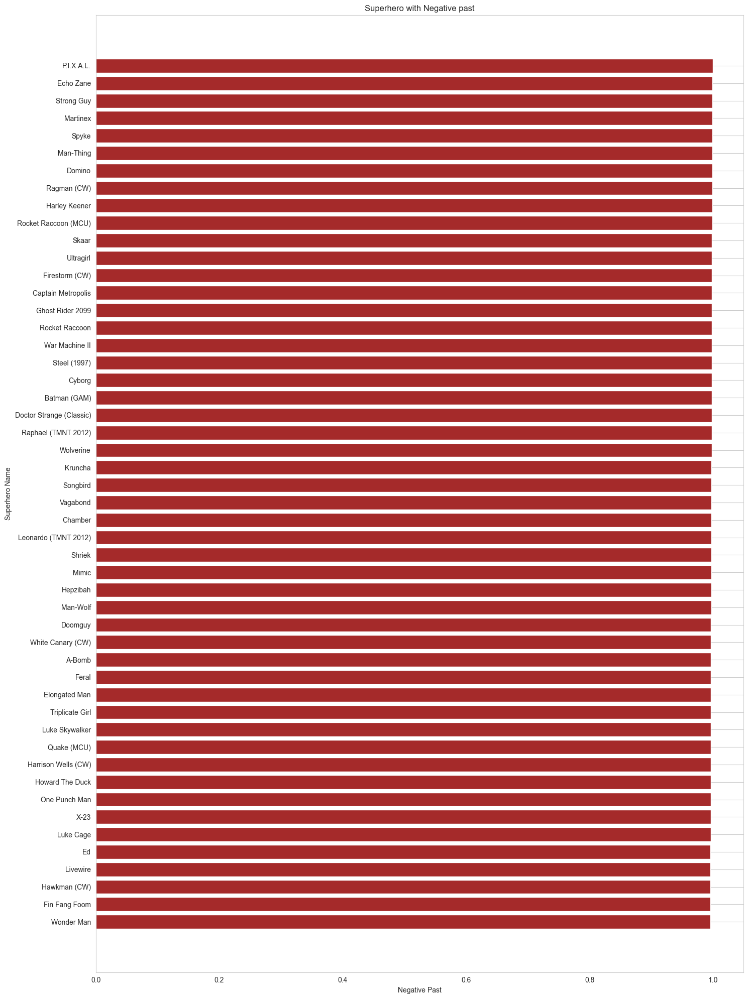

In [241]:
# Sorting the most powerful heroes by creator for better visualization
sort_superheroes_negative_past_positive_alignment = superheroes_negative_past_positive_alignment.sort_values('negative_prob', ascending=False)

# Visualizing the most powerful superheroes by creator based on overall_score
plt.figure(figsize=(15, 20))
plt.barh(sort_superheroes_negative_past_positive_alignment.head(50)['name'], sort_superheroes_negative_past_positive_alignment.head(50)['negative_prob'], color='brown')
plt.xlabel('Negative Past')
plt.ylabel('Superhero Name')
plt.title('Superhero with Negative past')
plt.gca().invert_yaxis()  # Invert y-axis for better readability
plt.grid(axis='x')


plt.tight_layout()
plt.show()

In [280]:
# import spacy
# import umap.umap_ as umap
# import seaborn as sns
# import matplotlib.pyplot as plt

# # Load spaCy's English NLP model with large word vectors
# nlp = spacy.load('en_core_web_lg')

# # Define a function to get the average word vector for a text using spaCy
# def get_spacy_embedding(text):
#     return nlp(text).vector

# df_filtered = df[df.history_text != 'Unknown']
# # Get embeddings for each history_text using spaCy
# embeddings_spacy = df_filtered['history_text'].fillna("").apply(get_spacy_embedding).tolist()

In [340]:
from transformers import BertTokenizer, BertModel
import torch
import numpy as np

# Load BERT tokenizer and model
tokenizer = BertTokenizer.from_pretrained('bert-base-uncased')
model = BertModel.from_pretrained('bert-base-uncased')

def get_bert_embedding(text):
    # Tokenize text and get output from BERT model
    inputs = tokenizer(text, return_tensors="pt", truncation=True, padding=True, max_length=512)
    with torch.no_grad(): 
        outputs = model(**inputs)
    # Extract the embeddings for the [CLS] token, which can be used as a sentence representation
    return outputs.last_hidden_state[:, 0, :].numpy()

# Get embeddings for each history_text using BERT
embeddings_bert = df_filtered['history_text'].fillna("").apply(get_bert_embedding).tolist()

In [345]:
# Convert embeddings_bert to a 2D array
embeddings_bert_array = np.array(embeddings_bert).squeeze()

In [346]:
# Reduce dimensionality using UMAP
#reduced_embeddings_spacy = umap.UMAP().fit_transform(embeddings_spacy)
reduced_embeddings_bert = umap.UMAP().fit_transform(embeddings_bert_array)

In [347]:
from bokeh.plotting import figure, show, output_notebook
from bokeh.models import HoverTool, ColumnDataSource
from bokeh.layouts import column
from bokeh.palettes import Category20

# Ensure the output is shown within the notebook
output_notebook()

# Create a dataframe from the embeddings for easy integration with Bokeh
df_bokeh = pd.DataFrame({
    'UMAP 1': reduced_embeddings_bert[:, 0],
    'UMAP 2': reduced_embeddings_bert[:, 1],
    'History': df_filtered['history_text'],
    'Creator': df_filtered['creator'],
    'Name': df_filtered['name']
})

# Convert the 'Name' column to unique integer codes
df_bokeh['color_codes'] = pd.factorize(df_bokeh['Creator'])[0]

# Create a color map based on the unique names using the Category20 palette
palette = Category20[20]
df_bokeh['colors'] = df_bokeh['color_codes'].map(lambda x: palette[x % 20])

# Convert dataframe to ColumnDataSource for Bokeh
source = ColumnDataSource(df_bokeh)

# Create the Bokeh figure
p.scatter(x='UMAP 1', y='UMAP 2', source=source, alpha=0.5, size=8, color='colors', legend_field='Creator')

# Add a scatter plot to the figure
p.scatter(x='UMAP 1', y='UMAP 2',fill_color='Creator',source=source, alpha=0.5, size=8)

# Hide the legend
p.legend.visible = False

# Customize the plot tools
hover = HoverTool()
hover.tooltips = [
    ("Creator", "@{Creator}"),
    ("Name", "@{Name}"),
    ("History", "@History"),
    ("", "-")
]
p.add_tools(hover)

# Customize the plot axes and grid
p.xaxis.axis_label = "UMAP 1"
p.yaxis.axis_label = "UMAP 2"

# Show the plot
show(p)


Loading BokehJS ...

GlyphRenderer(id='p1978', ...)

GlyphRenderer(id='p1989', ...)

ERROR:bokeh.core.validation.check:E-1006 (NON_MATCHING_DATA_SOURCES_ON_LEGEND_ITEM_RENDERERS): LegendItem.label is a field, but renderer data sources don't match: LegendItem(id='p1910', ...)


#### 8) Report on the 10 superheroes with most relatives, status of those relatives where possible, and the alignment of those superheroes.

In [301]:
df['relatives_count'] = df['relatives'].fillna("").apply(lambda x: len(x.split(',')) if x else 0)

In [303]:
# Let's begin by identifying characters based on the number of superpowers they possess
df['num_superpowers'] = df['superpowers'].fillna("").apply(lambda x: len(x.split(",")) if x else 0)

# Identify top characters based on the number of superpowers
top_superpowers_characters = df.nlargest(5, 'num_superpowers')[['name', 'num_superpowers', 'alignment', 'history_text']]

# Identify top characters based on the number of relatives
top_relative_characters = df.nlargest(5, 'relatives_count')[['name', 'relatives_count', 'alignment', 'history_text']]

In [379]:
 top_relative_characters.to_clipboard()

#### 9) Find out any other interesting insights from given data.
- a. Which 3 comic characters can you recommend to your friends to read or
watch?

To recommend comic characters from the dataset, we can take a data-driven approach by considering multiple factors:

- Popularity Metrics: If the dataset has columns indicating the popularity of a character, such as "number of appearances" or "number of series," we can use these metrics to identify popular characters.

- Superpowers: Characters with a diverse set of superpowers can be intriguing. We can identify characters with the most number of unique superpowers.

- Alignment and History: Heroes with a rich backstory or those who have transitioned from being villains to heroes (or vice-versa) can be compelling. We can explore the alignment and history_text columns for this.

- Relative Connections: Characters deeply connected to other characters (through relatives or affiliations) can be central figures in their universes and might have intricate storylines.

- General Popularity: Certain characters, like Batman, Superman, or Spider-Man, are globally renowned. If such characters are present in the dataset, they are usually safe recommendations.

<Figure size 1200x800 with 0 Axes>

/var/folders/_k/hvj2j92j10v0n49lt6p25wyw0000gp/T/ipykernel_55554/1232236517.py:12: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='num_teams', y='name', data=top_10_characters_teams, palette='viridis')


<Axes: xlabel='num_teams', ylabel='name'>

Text(0.5, 1.0, 'Top 10 Popular Superheroes Based on Team Affiliations')

Text(0.5, 0, 'Number of Teams')

Text(0, 0.5, 'Superhero')

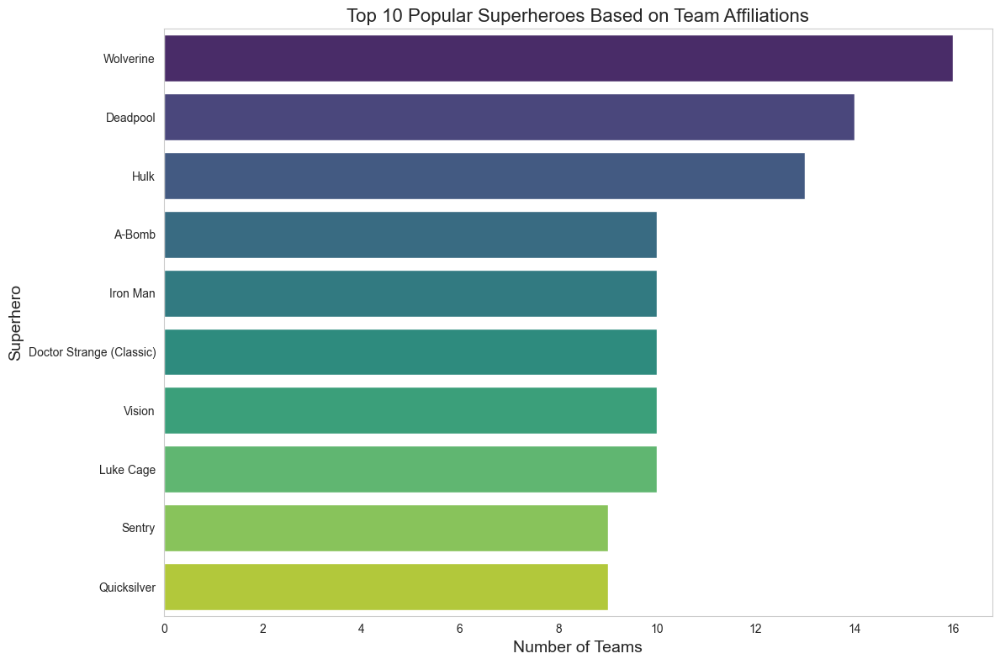

In [331]:
# Calculate the number of teams each superhero is associated with
df['num_teams'] = df['teams'].fillna("").apply(lambda x: len(x.split(",")) if x else 0)

# Sort the dataset by the number of teams in descending order
sorted_by_teams = df.sort_values(by='num_teams', ascending=False)

# Extract the data for the top 10 superheroes based on team affiliations
top_10_characters_teams = sorted_by_teams[['name', 'num_teams']].head(10)

# Plot
plt.figure(figsize=(12, 8))
sns.barplot(x='num_teams', y='name', data=top_10_characters_teams, palette='viridis')
plt.title('Top 10 Popular Superheroes Based on Team Affiliations', fontsize=16)
plt.xlabel('Number of Teams', fontsize=14)
plt.ylabel('Superhero', fontsize=14)
plt.grid(axis='x')
plt.tight_layout()

plt.show()

In [382]:
top_10_characters_teams.to_clipboard()